# Task 2: Model Training

Implement and configure the YOLO object detection model using a suitable framework.
Train the model on the prepared training dataset using appropriate hyperparameters. Monitor the training progress and ensure convergence.

**Connect google drive**

In [23]:
# Check if NVIDIA GPU is enabled
!nvidia-smi

Tue Aug 15 17:44:01 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Connect with google drive

In [43]:
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive
!ls /mydrive

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
ln: failed to create symbolic link '/mydrive/My Drive': File exists
'5 Accomplishment Statements Assignment template202210SHR.docx'
'5 Achievement assignment. Yamileth Hercules.docx'
'Assignment 5 DANA 4810'
'Biometrics Letter Samuel.pdf'
 Budget.gsheet
'Catering Event Briefing Notes.docx'
'Certificado Feedback Online - Yamileth H.png'
 cleaned_data_part2.csv
'Colab Notebooks'
'Copia de Team Member Evaluation.gdoc'
 Currículum.gdoc
 CV
'CV- Yamileth Hércules. Ingeniera Industrial (1).pdf'
'Documento sin título (1).gdoc'
'Documento sin título.gdoc'
 Ecel
'FlowRepository_FR-FCM-Z48W_files 2'
'Formulario sin título.gform'
 Help.gdoc
'Jupyter Notebook'
 Langara
'Letter of Invitation.docx'
 LR
'Mayor'\''s Budget Task Force - Non-Disclosure and Confidentiality Agreement with attached Appendix A (02002294-2xD3527).DOCX (1) (1).gdoc'
'Mayor'\''s Budget Task Fo

**1) Clone the Darknet**



In [25]:
!git clone https://github.com/AlexeyAB/darknet

fatal: destination path 'darknet' already exists and is not an empty directory.


**2) Compile Darknet using Nvidia GPU**


In [26]:
# change makefile to have GPU and OPENCV enabled
%cd darknet
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile
!make

[Errno 20] Not a directory: 'darknet'
/content/darknet
chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -rdynamic -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used []8;;https://gcc.gnu.org/onlinedocs/gcc/Warning-Options.html#index-Wunused-but-set-variable-Wunused-but-set-variable]8;;]
  946 |                 float rgb[3];
      |                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:

**3) Configure Darknet network for training YOLO V3**

#### Creating a training configuration file

In [ ]:
!cp cfg/yolov3.cfg cfg/yolov3_training.cfg

In [ ]:
!sed -i 's/batch=1/batch=64/' cfg/yolov3_training.cfg # Set for training
!sed -i 's/subdivisions=1/subdivisions=16/' cfg/yolov3_training.cfg  # Set for training
!sed -i 's/max_batches = 500200/max_batches = 20000/' cfg/yolov3_training.cfg #(2000 *n)
!sed -i '610 s@classes=80@classes=10@' cfg/yolov3_training.cfg
!sed -i '696 s@classes=80@classes=10@' cfg/yolov3_training.cfg
!sed -i '783 s@classes=80@classes=10@' cfg/yolov3_training.cfg
!sed -i '603 s@filters=255@filters=45@' cfg/yolov3_training.cfg # (n+5)*3
!sed -i '689 s@filters=255@filters=45@' cfg/yolov3_training.cfg #  (n+5)*3
!sed -i '776 s@filters=255@filters=45@' cfg/yolov3_training.cfg # (n+5)*3

### Documentation Training Yolo V3 form Github:

* Create file yolo-obj.cfg with the same content as in yolov3.cfg (or copy yolov3.cfg to yolo-obj.cfg) and:
* change line batch to batch=64
* change line subdivisions to subdivisions=8
* change line classes=80 to your number of objects in each of 3 [yolo]-layers:

[layer 610](https://github.com/AlexeyAB/darknet/blob/0039fd26786ab5f71d5af725fc18b3f521e7acfd/cfg/yolov3.cfg#L610)

[layer 696](https://github.com/AlexeyAB/darknet/blob/0039fd26786ab5f71d5af725fc18b3f521e7acfd/cfg/yolov3.cfg#L696)

[layer 783](https://github.com/AlexeyAB/darknet/blob/0039fd26786ab5f71d5af725fc18b3f521e7acfd/cfg/yolov3.cfg#L783)

* change [filters=255] to filters=(classes + 5)x3 in the 3 [convolutional] before each [yolo] layer

[layer 610](https://github.com/AlexeyAB/darknet/blob/0039fd26786ab5f71d5af725fc18b3f521e7acfd/cfg/yolov3.cfg#L603)

[layer 696](https://github.com/AlexeyAB/darknet/blob/0039fd26786ab5f71d5af725fc18b3f521e7acfd/cfg/yolov3.cfg#L689)

[layer 783](https://github.com/AlexeyAB/darknet/blob/0039fd26786ab5f71d5af725fc18b3f521e7acfd/cfg/yolov3.cfg#L776)


In [ ]:
# Create folder on google drive so that we can save there the weights
!mkdir "/mydrive/yolov3"

After the above code we should have the file create in google drive.


<img width="317" alt="Screen Shot 2023-08-15 at 09 49 00" src="https://user-images.githubusercontent.com/113282077/260780669-672aa192-0ce6-47b3-af02-074cb0486fa0.png">

In [ ]:
# Create obj.names file with class names
!echo -e 'avocados\nbroccoli\ngreen zucchinis\nbaby carrots\nblueberries\nlimes\nmandarins\nonions\nred mangos\ntomatoes' > data/obj.names

# Create obj.data file with dataset information
!echo -e 'classes= 10\ntrain  = data/train.txt\nvalid  = data/test.txt\nnames = data/obj.names\nbackup = /mydrive/yolov3' > data/obj.data

# Create directory for annotations and images
!mkdir data/obj

In [ ]:
# Save yolov3_training.cfg and obj.names files in Google drive
!cp cfg/yolov3_training.cfg /mydrive/yolov3/yolov3_testing.cfg
!cp data/obj.names /mydrive/yolov3/classes.txt
!cp data/obj.data /mydrive/yolov3/obj.data

As we can see in the screenshot below the folders created.

<img width="355" alt="Screen Shot 2023-08-15 at 10 10 55" src="https://user-images.githubusercontent.com/113282077/260785579-c16d52a8-a236-47f5-9f6d-afd4f1620547.png">


In [ ]:
# Download weights darknet model 53
!wget https://pjreddie.com/media/files/darknet53.conv.74

--2023-08-15 17:33:44--  https://pjreddie.com/media/files/darknet53.conv.74
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 162482580 (155M) [application/octet-stream]
Saving to: ‘darknet53.conv.74’

darknet53.conv.74   100%[===================>] 154.96M   104MB/s    in 1.5s    

2023-08-15 17:33:46 (104 MB/s) - ‘darknet53.conv.74’ saved [162482580/162482580]



**4) Extract Images**

The images need to be inside a zip archive called "images.zip" and they need to be inside the folder "yolov3" on Google Drive

In [ ]:
!unzip -o /mydrive/yolov3/images.zip -d data/obj

Archive:  /mydrive/yolov3/images.zip
  inflating: data/obj/avocados_4.jpg  
  inflating: data/obj/__MACOSX/._avocados_4.jpg  
  inflating: data/obj/avocados_4.xml.txt  
  inflating: data/obj/__MACOSX/._avocados_4.xml.txt  
  inflating: data/obj/avocados_6.jpg  
  inflating: data/obj/__MACOSX/._avocados_6.jpg  
  inflating: data/obj/avocados_6.txt  
  inflating: data/obj/__MACOSX/._avocados_6.txt  
  inflating: data/obj/avocados_7.jpg  
  inflating: data/obj/__MACOSX/._avocados_7.jpg  
  inflating: data/obj/avocados_7.txt  
  inflating: data/obj/avocados_9.jpg  
  inflating: data/obj/__MACOSX/._avocados_9.jpg  
  inflating: data/obj/avocados_9.txt  
  inflating: data/obj/avocados_10.jpg  
  inflating: data/obj/__MACOSX/._avocados_10.jpg  
  inflating: data/obj/avocados_10.txt  
  inflating: data/obj/__MACOSX/._avocados_10.txt  
  inflating: data/obj/avocados_12.jpg  
  inflating: data/obj/__MACOSX/._avocados_12.jpg  
  inflating: data/obj/avocados_12.txt  
  inflating: data/obj/__MACOSX

We can find the folder with the images here:

<img width="342" alt="Screen Shot 2023-08-15 at 10 17 49" src="https://user-images.githubusercontent.com/113282077/260786857-a35152cc-55c5-4a89-b815-3878eb799ad6.png">


**5) Create traing and test dataset**

In [42]:
# Create the train and test dataset from images
import glob
from sklearn.model_selection import train_test_split
images_list = glob.glob("data/obj/*.jpg")
print(images_list)
train,test = train_test_split(images_list,test_size= 0.2)


['data/obj/limes_15.jpg', 'data/obj/red mangos_6.jpg', 'data/obj/mandarins_13.jpg', 'data/obj/broccoli_10.jpg', 'data/obj/limes_4.jpg', 'data/obj/broccoli_4.jpg', 'data/obj/onions_7.jpg', 'data/obj/red mangos_11.jpg', 'data/obj/limes_19.jpg', 'data/obj/baby carrots_6.jpg', 'data/obj/blueberries_13.jpg', 'data/obj/avocados_12.jpg', 'data/obj/broccoli_9.jpg', 'data/obj/onions_14.jpg', 'data/obj/broccoli_11.jpg', 'data/obj/baby carrots_19.jpg', 'data/obj/onions_11.jpg', 'data/obj/red mangos_15.jpg', 'data/obj/blueberries_12.jpg', 'data/obj/red mangos_4.jpg', 'data/obj/tomatoes_11.jpg', 'data/obj/limes_12.jpg', 'data/obj/limes_14.jpg', 'data/obj/blueberries_7.jpg', 'data/obj/avocados_15.jpg', 'data/obj/red mangos_10.jpg', 'data/obj/tomatoes_13.jpg', 'data/obj/blueberries_5.jpg', 'data/obj/green zucchinis_8.jpg', 'data/obj/mandarins_8.jpg', 'data/obj/avocados_4.jpg', 'data/obj/tomatoes_20.jpg', 'data/obj/green zucchinis_13.jpg', 'data/obj/blueberries_4.jpg', 'data/obj/tomatoes_19.jpg', 'dat

In [36]:
# Create train.txt and test.txt files
fileTrain = open("data/train.txt", "w")
fileTrain.write("\n".join(train))
fileTrain.close()

fileTest = open("data/test.txt", "w")
fileTest.write("\n".join(test))
fileTest.close()

**6) Start the training**

In [ ]:
# Start the training
!./darknet detector train data/obj.data cfg/yolov3_training.cfg darknet53.conv.74 -dont_show

 CUDA-version: 11080 (12000), cuDNN: 8.9.0, GPU count: 1  
 OpenCV version: 4.5.4
yolov3_training
 0 : compute_capability = 750, cudnn_half = 0, GPU: Tesla T4 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 1 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shor

We should have all this files after trained the model.
<img width="1402" alt="Screen Shot 2023-08-15 at 09 53 25" src="https://user-images.githubusercontent.com/113282077/260781334-58f41225-2a81-47a3-8339-957e4cc6c331.png">


# Task 3: Model Evaluation on Superstore Flyers

Apply the trained model to real Canadian Superstore flyers. Detect and classify instances of vegetables or fruits in the flyer images.
Evaluate the model's performance in terms of precision, recall, and mean Average Precision (mAP). Discuss the results and potential areas for improvement.

In [56]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow


# Load Yolo
net = cv2.dnn.readNet("/mydrive/yolov3/yolov3_training_last.weights", "/mydrive/yolov3/yolov3_testing.cfg")

# Name custom object  is my class. Use your own
classes = ["green zucchinis"]

# Images path. This is my path for image files. Use yours. This needs to be changed. Just use few images from the overall dataset for testing.
!unzip -o /mydrive/yolov3/tests.zip -d data/testing
images_path = glob.glob(r"/content/darknet/data/testing/*.jpg")

Archive:  /mydrive/yolov3.1/tests.zip
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.jpg  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.jpg  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.txt  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.txt  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.jpg  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.jpg  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.txt  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.txt  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.jpg  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.jpg  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.txt  
  inflating: data/testing/__MACOSX/._9

()


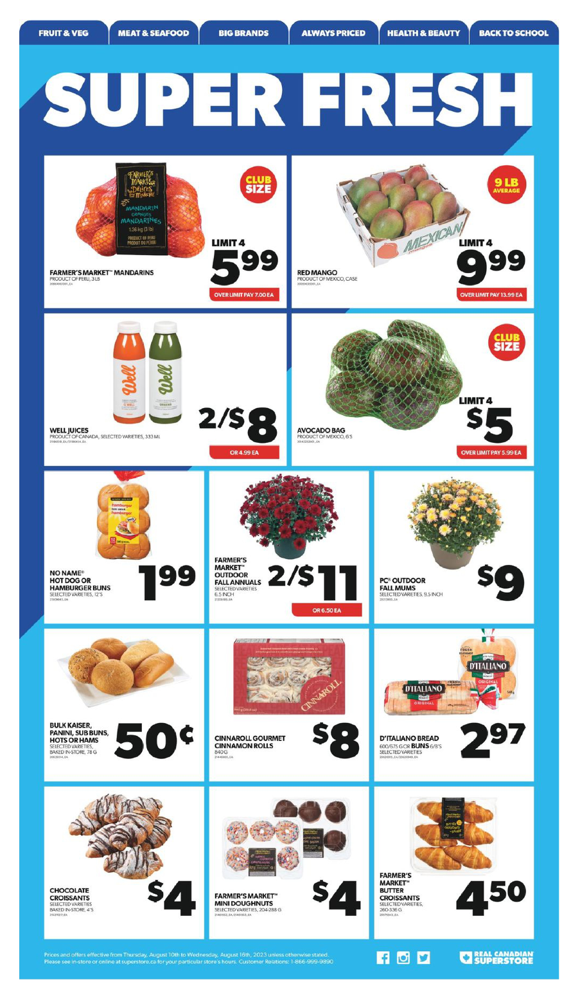

()


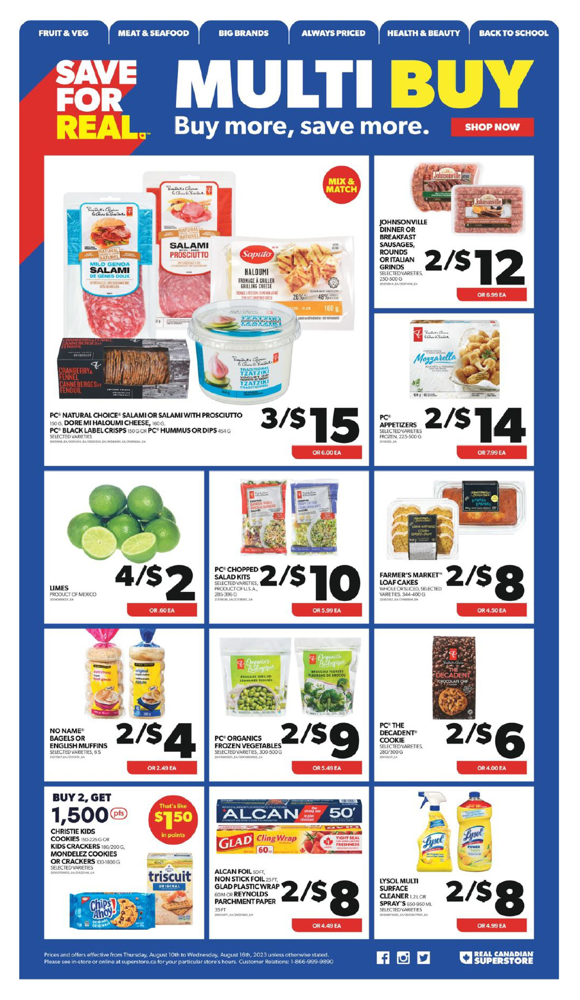

()


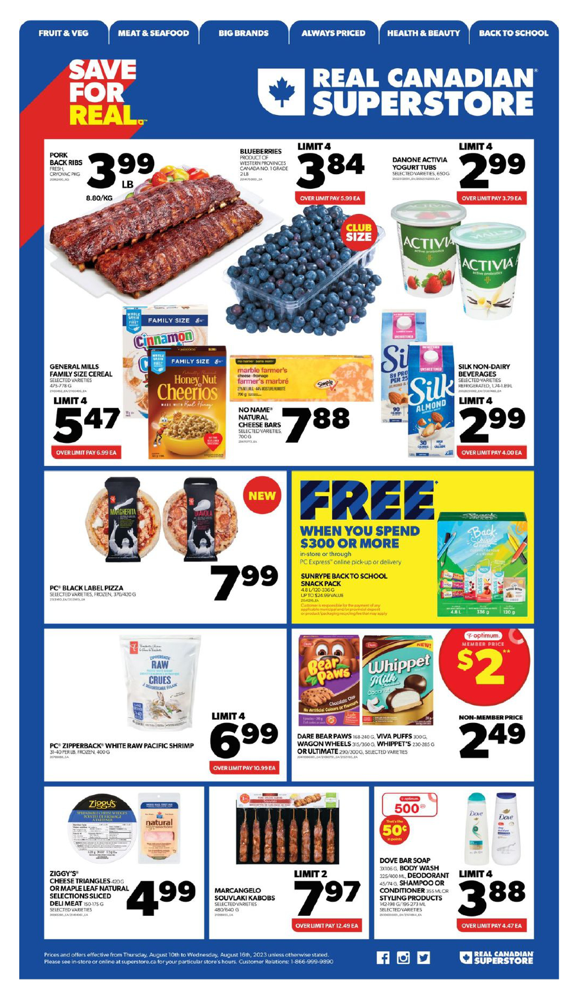

()


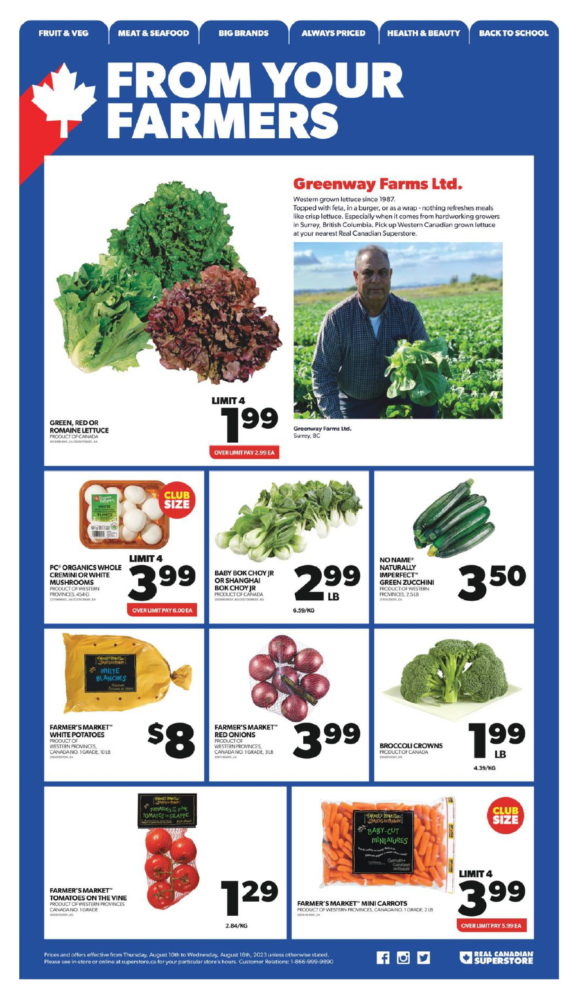

In [57]:

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]

# Loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    img = cv2.resize(img, None, fx=0.4, fy=0.4)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3 and class_id == 0:  # Class_id 0 corresponds to the first class
                # Object detected
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)
    print(indexes)
    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = class_name
            color = (0, 255, 0)  # Green color
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
            cv2.putText(img, label, (x, y + 30), font, 3, color, 2)

    cv2_imshow(img)
    key = cv2.waitKey(0)

cv2.destroyAllWindows()

###  Map for training data

In [37]:
!./darknet detector map /mydrive/yolov3/obj.data /mydrive/yolov3/yolov3_testing.cfg /mydrive/yolov3/yolov3_training_last.weights

 CUDA-version: 11080 (12000), cuDNN: 8.9.0, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 750, cudnn_half = 0, GPU: Tesla T4 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5, 

## Map for test data

In [38]:
!unzip -o /mydrive/yolov3/tests.zip -d data/test

Archive:  /mydrive/yolov3.1/tests.zip
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.jpg  
  inflating: data/test/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.jpg  
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.txt  
  inflating: data/test/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.txt  
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.jpg  
  inflating: data/test/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.jpg  
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.txt  
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.jpg  
  inflating: data/test/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.jpg  
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.txt  
  inflating: data/test/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0008.jpg  
  inflating: data/test/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0008.j

In [39]:
import glob
images_list = glob.glob("data/test/*.jpg")
with open("data/test.txt", "w") as f:
     f.write("\n".join(images_list))

In [41]:
!./darknet detector map /mydrive/yolov3/obj.data /mydrive/yolov3/yolov3_testing.cfg /mydrive/yolov3/yolov3_training_last.weights

 CUDA-version: 11080 (12000), cuDNN: 8.9.0, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 750, cudnn_half = 0, GPU: Tesla T4 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5, 

## Interpretation:

#### Training data

The results show precision, recall, F1-score, true positives (TP), false positives (FP), false negatives (FN), average IoU, and mean average precision (mAP@0.50) for an IoU threshold of 50%.

These results indicate that the model performs quite well on your training data. The precision, recall, and F1-score are all perfect (1.00), indicating that the model is achieving a high level of accuracy in detecting instances of the classes. The average IoU of 91.62% also indicates that the model's bounding box predictions are quite accurate.

The mean average precision (mAP@0.50) of 1.000000 (100%) suggests that the model achieves a perfect mAP score at the IoU threshold of 50%, meaning it has excellent performance in object detection.

#### Test data(flyers)
The evaluation results  show significantly different performance compared to the training data.

At a confidence threshold of 0.25:
Precision: 0.00
Recall: 0.00
F1-score: -nan (not a number)
True Positives (TP): 0
False Positives (FP): 21
False Negatives (FN): 11
Average IoU: 0.00%
IoU threshold of 50%:
Mean Average Precision (mAP@0.50): 0.000000 or 0.00%
These results suggest that the model is struggling to detect instances of the classes in the test data. The precision and recall are both at 0.00, indicating that the model is not making any correct positive predictions for this class. The F1-score being -nan also indicates that the model's performance is poor.

The mean average precision (mAP@0.50) of 0.000000 (0.00%) reinforces that the model's performance on these classes is not effective.

These results suggest that there might be a problem with the model's ability to generalize to unseen data or that the test data contains some challenges that the model has not learned to handle effectively.

For the issue with the Real Canadian Store flyers, my opinion is that the model have difficult to detect the objects due to that the model hasn't been trained on similar data or that the differences in image content and layout are causing the model to perform poorly. I think we could continue working and retrain the model with similar images; more diverse dataset that includes images with different layouts and content.

If the issues persist, we might need to fine-tune the model using additional training data or make adjustments to the model architecture and training parameters to better suit the specific type of images.



# Task 4: Multi-Class Detection and Probability Scores
Modify the model to enable multi-class detection, allowing the model to detect multiple vegetables or fruits within a single flyer image.
Implement a mechanism to provide probability scores for each detected class. Discuss the approach used to calculate these scores.

Archive:  /mydrive/yolov3.1/tests.zip
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.jpg  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.jpg  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.txt  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0001.txt  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.jpg  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.jpg  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.txt  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0002.txt  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.jpg  
  inflating: data/testing/__MACOSX/._991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.jpg  
  inflating: data/testing/991b2bb4-5ef2-40a8-a764-54bdc85674c2_page-0003.txt  
  inflating: data/testing/__MACOSX/._9

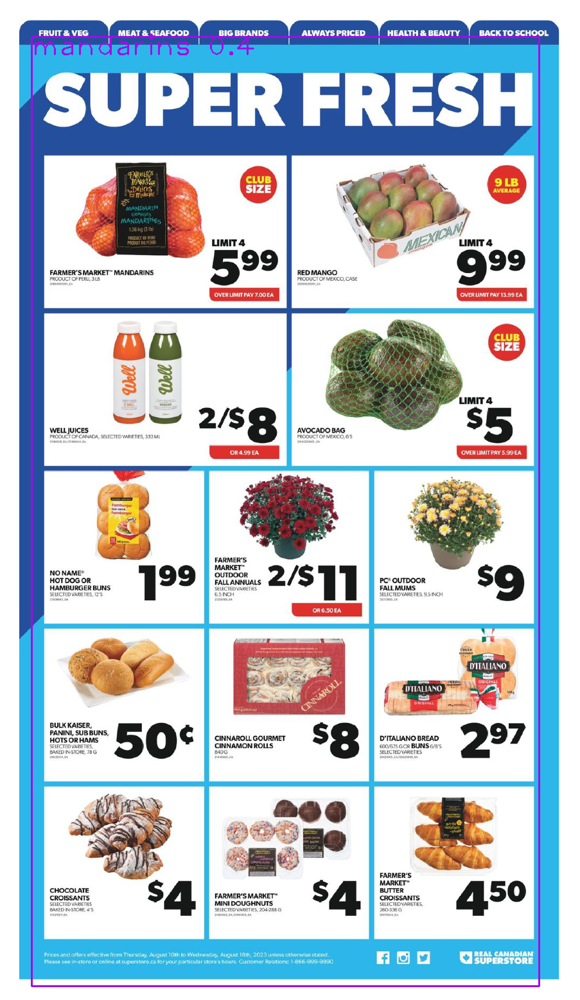

6
6
6
[0]


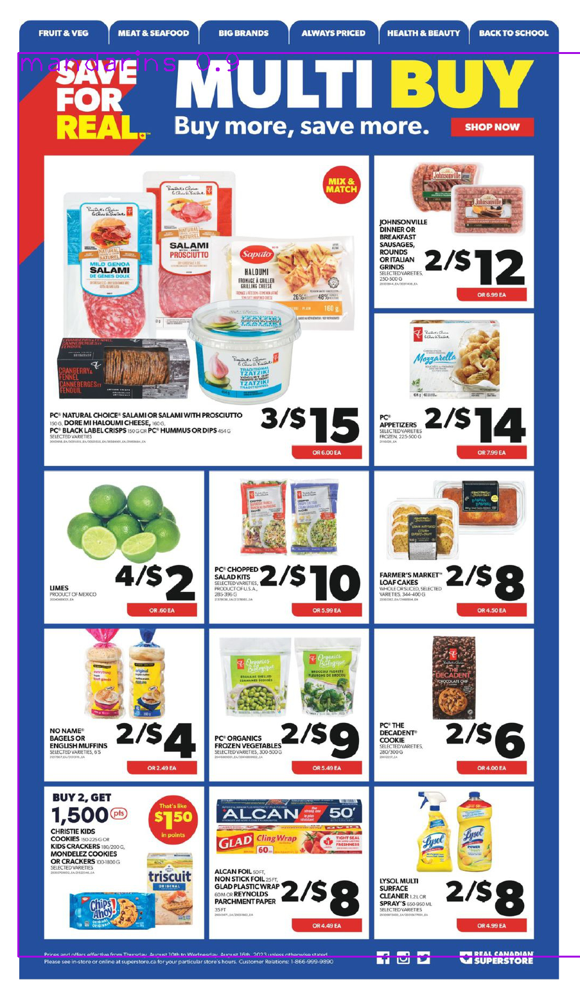

6
3
3
[0]


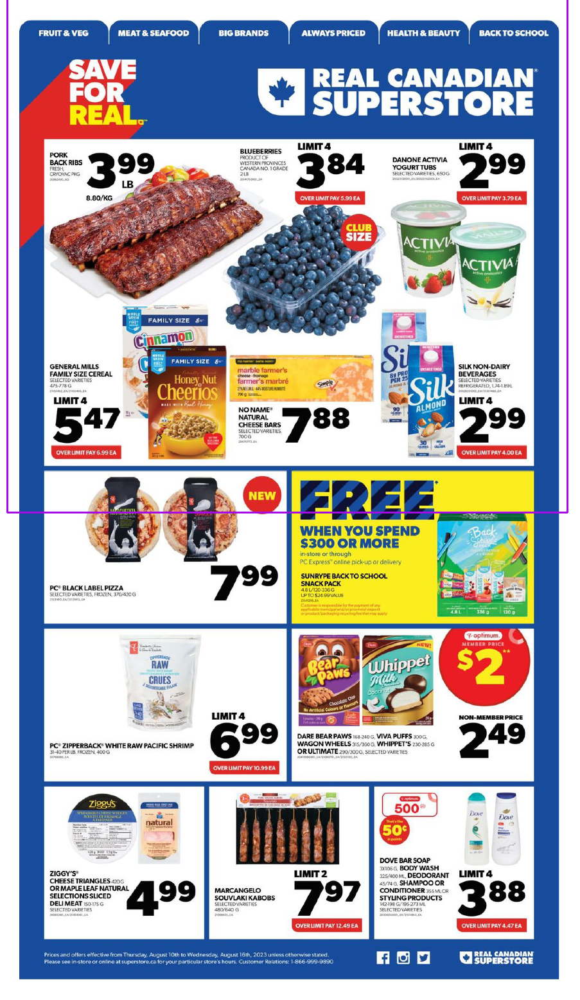

6
()


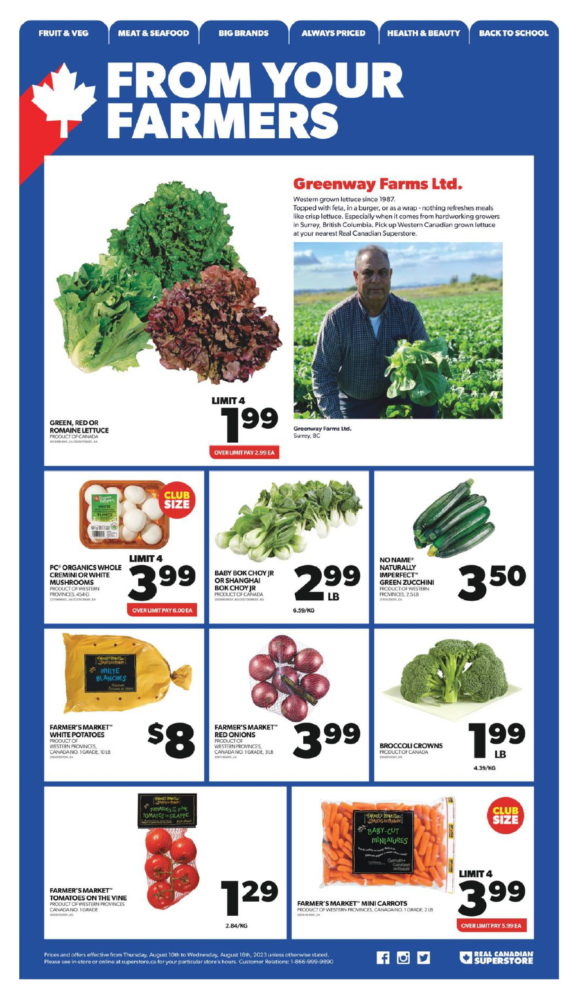

In [58]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

# Load Yolo
net = cv2.dnn.readNet("/mydrive/yolov3/yolov3_training_last.weights", "/mydrive/yolov3/yolov3_testing.cfg")

# Name custom object , for 10  classes.
classes = ["avocados",
    "broccoli",
    "green zucchinis",
    "baby carrots",
    "blueberries",
    "limes",
    "mandarins",
    "onions",
    "red mangos",
    "tomatoes"]

!unzip -o /mydrive/yolov3/tests.zip -d data/testing
# Images path. This is my path for image files. Use yours. This needs to be changed. Just use few images from the overall dataset for testing.
images_path = glob.glob(r"/content/darknet/data/testing/*.jpg")

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# Insert here the path of your images
#random.shuffle(images_path)
# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    img = cv2.resize(img, None, fx=0.4, fy=0.4)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                # Object detected
                print(class_id)
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)
    print(indexes)
    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            confidence = str(round(confidences[i],2)) # To get the confidence score
            color = colors[class_ids[i]]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
            cv2.putText(img, label + " " + confidence, (x, y + 30), font, 3, color, 2)# To print the image, the label and confidence score


    cv2_imshow(img)
    key = cv2.waitKey(1)

cv2.destroyAllWindows()



Archive:  /mydrive/yolov3.1/test1.zip
  inflating: data/testing1/avocados_8.jpg  
  inflating: data/testing1/__MACOSX/._avocados_8.jpg  
  inflating: data/testing1/baby carrots_4.jpg  
  inflating: data/testing1/__MACOSX/._baby carrots_4.jpg  
  inflating: data/testing1/red mangos_5.jpg  
  inflating: data/testing1/__MACOSX/._red mangos_5.jpg  
  inflating: data/testing1/tomatoes_8.jpg  
  inflating: data/testing1/__MACOSX/._tomatoes_8.jpg  
  inflating: data/testing1/tomatoes_10.jpg  
  inflating: data/testing1/__MACOSX/._tomatoes_10.jpg  
  inflating: data/testing1/tomatoes_16.jpg  
  inflating: data/testing1/__MACOSX/._tomatoes_16.jpg  
3
3
[1]


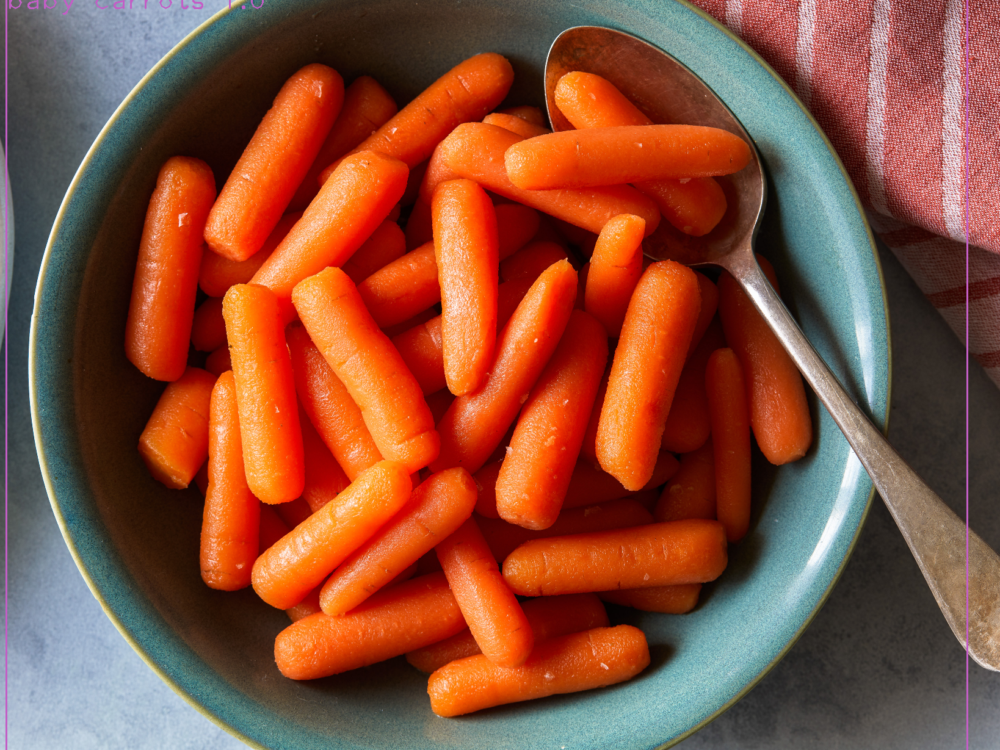

()


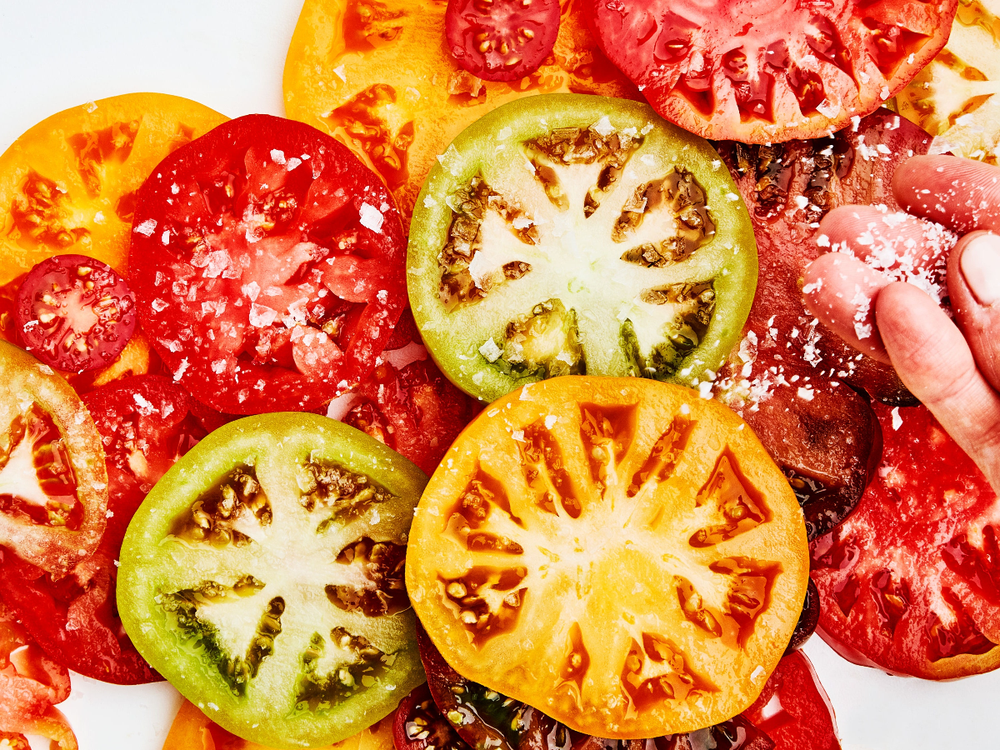

0
0
[1]


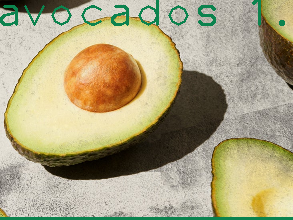

8
[0]


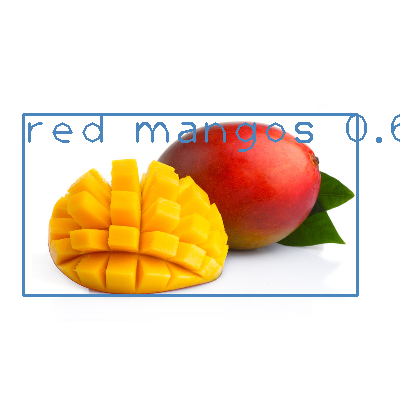

9
9
[1]


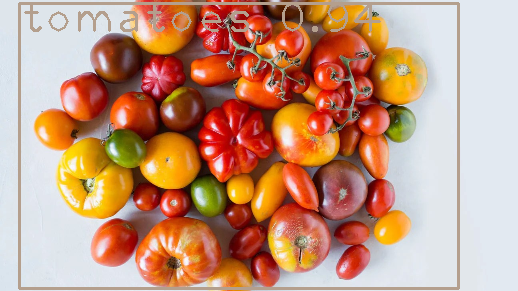

()


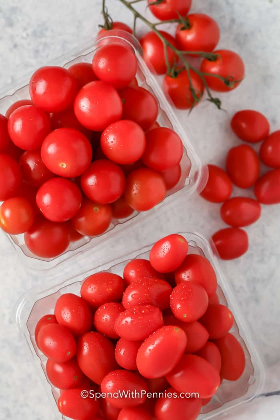

In [60]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

# Load Yolo
net = cv2.dnn.readNet("/mydrive/yolov3.1/yolov3_training_last.weights", "/mydrive/yolov3.1/yolov3_testing.cfg")

# Name custom object , for 10  classes.
classes = ["avocados",
    "broccoli",
    "green zucchinis",
    "baby carrots",
    "blueberries",
    "limes",
    "mandarins",
    "onions",
    "red mangos",
    "tomatoes"]

!unzip -o /mydrive/yolov3.1/test1.zip -d data/testing1
# Images path. This is my path for image files. Use yours. This needs to be changed. Just use few images from the overall dataset for testing.
images_path = glob.glob(r"/content/darknet/data/testing1/*.jpg")

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# Insert here the path of your images
#random.shuffle(images_path)
# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    img = cv2.resize(img, None, fx=0.4, fy=0.4)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                # Object detected
                print(class_id)
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)
    print(indexes)
    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            confidence = str(round(confidences[i],2)) #To get the confidence score
            color = colors[class_ids[i]]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
            cv2.putText(img, label + " " + confidence, (x, y + 30), font, 3, color, 2) # To print the image, the label and confidence score


    cv2_imshow(img)
    key = cv2.waitKey(1)

cv2.destroyAllWindows()

# Task 5 Reporting and Documentation

## Model Arquitecture

- YOLOV3
- Changes: Maxbatches, Filters, Classes and Batch

## Conclusions of the model:

The conclusions drawn from the model's performance, based on the observed results, are as follows:

### * Limited Variability in Training Data

 The model seems to perform well on images that are similar to the training data it was exposed to. However, it struggles with images that have a different structure or content. This suggests that the training dataset might lack diversity in terms of object poses, lighting conditions, backgrounds, and other factors. The model's ability to generalize to unseen data is limited due to this lack of variability in the training set.

### * Flyers vs. Individual Images

The model's inability to detect objects in images with a different structure might be due to the fact that the training data consists of individual images, while the test images are parts of flyers containing multiple objects. Flyers often have cluttered backgrounds and various objects in close proximity, which can make object detection challenging for models trained on single object images.

### * Limited Quantity of Training Data

The model's struggles with detecting objects in diverse and complex images can also be attributed to the limited quantity of training data used. Training the model with only 100 photos might not provide sufficient examples to capture the wide range of variations present in real-world scenarios. This small training dataset limits the model's ability to learn intricate features, poses, and backgrounds that are common in object detection tasks. To achieve more robust and accurate results, it's recommended to gather and annotate a larger dataset that better represents the diversity of objects and scenarios encountered during testing. Increasing the dataset size can help the model generalize better and improve its ability to detect objects in challenging images, such as flyers containing multiple items.

### * Overfitting to Simple Images

If the training data mainly consists of simple images, the model might have overfit to these specific characteristics. As a result, it struggles with more complex and diverse scenes present in the test images. Overfitting occurs when the model learns to perform well on the training data but fails to generalize to new, unseen data.

### * Data Augmentation

If data augmentation techniques were not used during training, the model may not have learned to handle different variations of the same object. Augmentation, such as random rotations, translations, and changes in lighting, helps the model become more robust to diverse scenarios.

### * Need for More Diverse Data

To improve the model's performance on diverse test images, it's crucial to include a more varied dataset during training. This should include images with different backgrounds, lighting conditions, object poses, and scales. Incorporating images that resemble the complexity of the test images, such as flyers, can help the model generalize better.

Furthermore, there are other crucial aspects that could potentially enhance the model's performance. These include fine-tuning hyperparameters to optimize the learning process, exploring the utilization of more advanced architectures such as YOLO4, YOLO5, or YOLO7 to leverage the latest advancements in object detection techniques. It's also important to acknowledge that ongoing model refinement can be achieved by continually training the model on larger and more diverse datasets. This iterative approach ensures that the model's capability to detect objects in various contexts and scenarios is continuously enhanced.

## Insights gained from the project,

Insights Gained and Challenges Faced:

### * Time-Consuming Training

The training process for an accurate object detection model can be quite time-consuming. Optimizing training schedules, batch sizes, and learning rates is essential to efficiently use computational resources.

### * Hyperparameter Understanding

A thorough understanding of hyperparameters is crucial. Incorrect choices can lead to the need for retraining, resulting in wasted time and effort. Careful selection and fine-tuning are key to achieving desired outcomes.

### * YOLO Model Variants

Different versions of YOLO models, such as YOLOv3, YOLOv4, and YOLOv5, offer varying capabilities and enhancements. Close adherence to documentation is vital to navigate and utilize these models effectively.

### * Google Colab Challenges

While Google Colab provides valuable resources for training and inference, connectivity issues and disconnections can disrupt progress, particularly during extended training sessions. Mitigation strategies are important to ensure consistent workflow.
Potential Enhancements:

### * Advanced Architectures

Exploring more advanced model architectures, such as YOLOv4 or YOLOv5, can offer improved performance and accuracy in object detection tasks.
Cloud-Based Computing: Leveraging cloud-based computing platforms can help address computational constraints, enabling more comprehensive model training and experimentation.

### * Optimized Training Data

Enhancing training data quality and diversity can lead to better model generalization, allowing it to perform effectively across a wider range of scenarios.
Robustness Techniques: Investigating techniques to enhance model robustness, such as data augmentation, transfer learning, and fine-tuning, can improve detection accuracy in challenging scenarios.
### * Model Interpretatio

Implementing methods to interpret model predictions and visualize decision-making processes can provide valuable insights into the model's behavior and areas for improvement.

In conclusion, this project has offered valuable insights into the intricacies of object detection. By addressing challenges and embracing enhancements, I've learned to optimize training processes, choose appropriate hyperparameters, leverage various YOLO models, and navigate challenges posed by cloud-based platforms. These lessons will undoubtedly contribute to future successes in object detection projects.